- develop a model to match individual whales and dolphins by unique-but often subtle-characteristics of their natural markings

- pay particular attention to dorsal fins and lateral body views in image sets from a multi-species dataset built by 28 research institutions

개발 방향
- few-shot learning
- metric learning

1. 검색하고자 하는 이미지 feature 추출
2. 추출한 feature를 사전에 구축된 DB에서 검색

- Identification : 여러 사람 중 'A' 찾기
- Verification : 'A'가 맞는지 확인

- 51033장의 이미지 중  15587 개의 individual id를 구분해야하는 문제다.
- 각 15587개의 클래스 어림잡아 3장(51033/15587)씩 주어진다고 할 수 있다.
- 개발방향은 몇 장의 이미지를 가지고 각 이미지가 짝인지 아닌지 구분할 수 있는 few-shot learning, metric learning쪽으로 잡아야한다.


직접 살펴보기

- 흑백 사진 존재
- 가로, 세로 길이 상이 -> 어떻게 리사이즈할지?

- 참고


[metric learning 관련](https://kmhana.tistory.com/14})



*** 흑백 이미지 존재함 ***

In [179]:
import pandas as pd
from glob import glob
import os
import matplotlib.pyplot as plt
import cv2
import torch
from tqdm import tqdm
from torch.optim import lr_scheduler

from colorama import Fore, Back, Style
b_ = Fore.BLUE
sr_ = Style.RESET_ALL

In [ ]:
print('abcd'+b_)

In [181]:
# wandb
import wandb

wandb.login()


True

In [197]:
CONFIG = {'train_img_dir' : 'train_images',
            'n_fold' : 5,
            'img_size' : 256,
            'embedding_size' : 256, 
            'train_batch_size' : 32,
            'valid_batch_size' : 64,
            'learning_rate' : 1e-4,
            'scheduler' : 'CosineAnnealingLR',
            'min_lr' : 1e-6,
            'epochs' : 3,
            'T_max' : 500,
            'weight_decay' : 1e-6,
            'margin' : 0,
            'n_accumulate' : 1,
            'device' : torch.device('cuda:0' if torch.cuda.is_available() else 'cpu'),
            'model_name' : 'tf_efficientnet_b0', 
        }


In [155]:
df = pd.read_csv('train.csv')
df

,image,species,individual_id
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9
1,000562241d384d.jpg,humpback_whale,1a71fbb72250
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392
...,...,...,...
51028,fff639a7a78b3f.jpg,beluga,5ac053677ed1
51029,fff8b32daff17e.jpg,cuviers_beaked_whale,1184686361b3
51030,fff94675cc1aef.jpg,blue_whale,5401612696b9
51031,fffbc5dd642d8c.jpg,beluga,4000b3d7c24e


In [156]:
df.describe()

# 15587개의 individual id와 30개의 species, 그리고 총 51033장의 이미지

,image,species,individual_id
count,51033,51033,51033
unique,51033,30,15587
top,00021adfb725ed.jpg,bottlenose_dolphin,37c7aba965a5
freq,1,9664,400


bottlenose_dolphin           9664
beluga                       7443
humpback_whale               7392
blue_whale                   4830
false_killer_whale           3326
dusky_dolphin                3139
spinner_dolphin              1700
melon_headed_whale           1689
minke_whale                  1608
killer_whale                 1493
fin_whale                    1324
gray_whale                   1123
bottlenose_dolpin            1117
kiler_whale                   962
southern_right_whale          866
spotted_dolphin               490
sei_whale                     428
short_finned_pilot_whale      367
common_dolphin                347
cuviers_beaked_whale          341
pilot_whale                   262
long_finned_pilot_whale       238
white_sided_dolphin           229
brydes_whale                  154
pantropic_spotted_dolphin     145
globis                        116
commersons_dolphin             90
pygmy_killer_whale             76
rough_toothed_dolphin          60
frasiers_dolph

<AxesSubplot:>

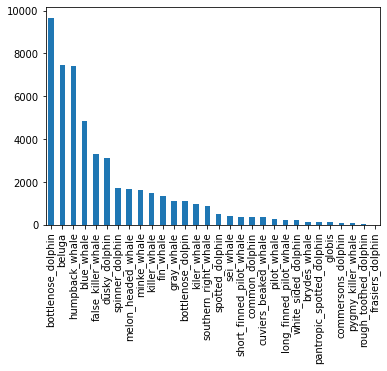

In [157]:
# species distribution (30종)
print(df.species.value_counts())
df.species.value_counts().plot(kind = 'bar')

<AxesSubplot:>

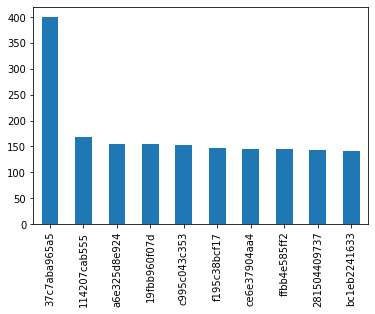

In [158]:
# individual id distribution: top 10
df.individual_id.value_counts()[:10].plot(kind = 'bar')

In [159]:
# fix wrong label
# beluga and globis to whale

# kiler -> killer
# bottlenose_dolpin -> bottlenose_dolphin
# https://www.kaggle.com/c/happy-whale-and-dolphin/discussion/304633

df.loc[df.species.str.contains('beluga'), 'species'] = 'beluga_whale'
df.loc[df.species.str.contains('globis'), 'species'] = 'short_finned_pilot_whale'
df.loc[df.species.str.contains('pilot_whale'), 'species'] = 'short_finned_pilot_whale'
df['class'] = df.species.map(lambda x: 'whale' if 'whale' in x else 'dolphin')

# fix duplicate labels
# https://www.kaggle.com/c/happy-whale-and-dolphin/discussion/304633
df['species'] = df['species'].str.replace('bottlenose_dolpin','bottlenose_dolphin')
df['species'] = df['species'].str.replace('kiler_whale','killer_whale')

In [160]:
df['image'] = df['image'].apply(lambda x : os.path.join(TRAIN_IMG_DIR, x))



0        train_images/00021adfb725ed.jpg
1        train_images/000562241d384d.jpg
2        train_images/0007c33415ce37.jpg
3        train_images/0007d9bca26a99.jpg
4        train_images/00087baf5cef7a.jpg
                      ...               
51028    train_images/fff639a7a78b3f.jpg
51029    train_images/fff8b32daff17e.jpg
51030    train_images/fff94675cc1aef.jpg
51031    train_images/fffbc5dd642d8c.jpg
51032    train_images/fffdcd42312777.jpg
Name: image, Length: 51033, dtype: object

In [78]:
def visualize_info(df, idx) :
    imgfile = os.path.join('train_images', df['image'][idx]) 
    species = df['species'][idx]
    ind_id = df['individual_id'][idx]

    img = plt.imread(imgfile)
    plt.imshow(img)
    print(f'species : {species}')
    print(f'id : {ind_id}')
    plt.show()
    

species : melon_headed_whale
id : cadddb1636b9


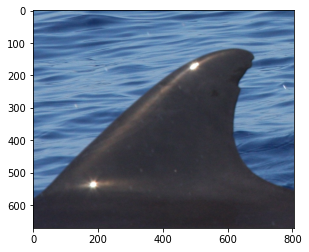

species : humpback_whale
id : 1a71fbb72250


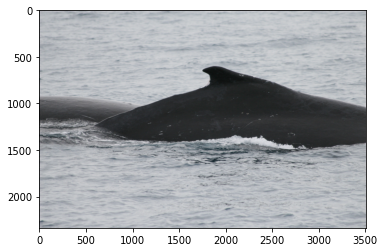

species : false_killer_whale
id : 60008f293a2b


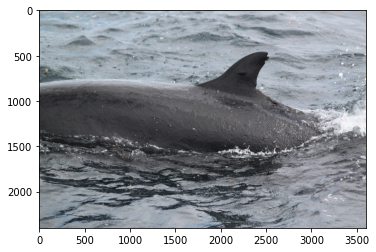

species : bottlenose_dolphin
id : 4b00fe572063


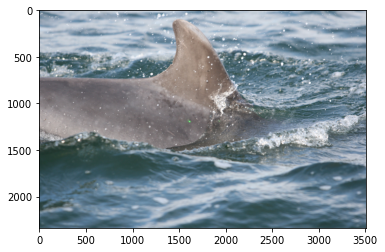

species : humpback_whale
id : 8e5253662392


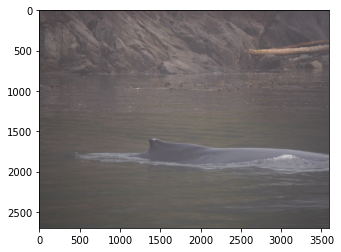

species : bottlenose_dolphin
id : b9907151f66e


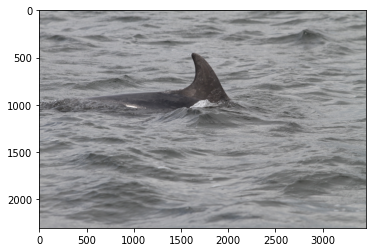

species : beluga_whale
id : afb9b3978217


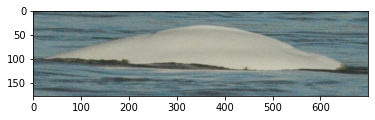

species : humpback_whale
id : 444d8894ccc8


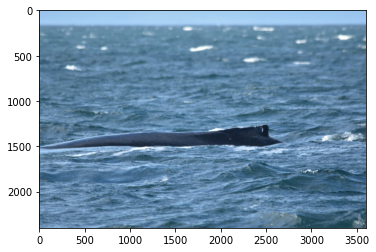

species : beluga_whale
id : df94b15285b9


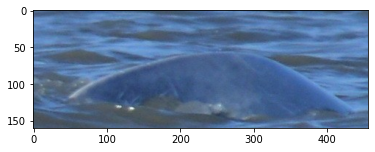

species : bottlenose_dolphin
id : b11b2404c7e3


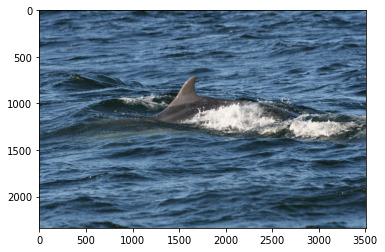

In [79]:
for i in range(10) :
    visualize_info(df, i)

In [23]:
unique_ids = pd.unique(df['individual_id'])

len(unique_ids)

15587

In [28]:
def visualize_id(df, ind_id) :
    by_id = df[df['individual_id'] == ind_id].copy()
    by_id.index =  range(len(by_id.index))
    img_list = by_id['image'].tolist()
    print(by_id['species'].tolist()[0])

    f, ax = plt.subplots(4,4, figsize = (16,16))
    
    for i in range(min(len(by_id), 16)) :
        imgfile = by_id.loc[i, 'image']
        img = plt.imread(os.path.join(TRAIN_IMG_DIR, imgfile))
        ax[i//4, i%4].imshow(img)
        ax[i//4, i%4].axis('off')

bottlenose_dolphin


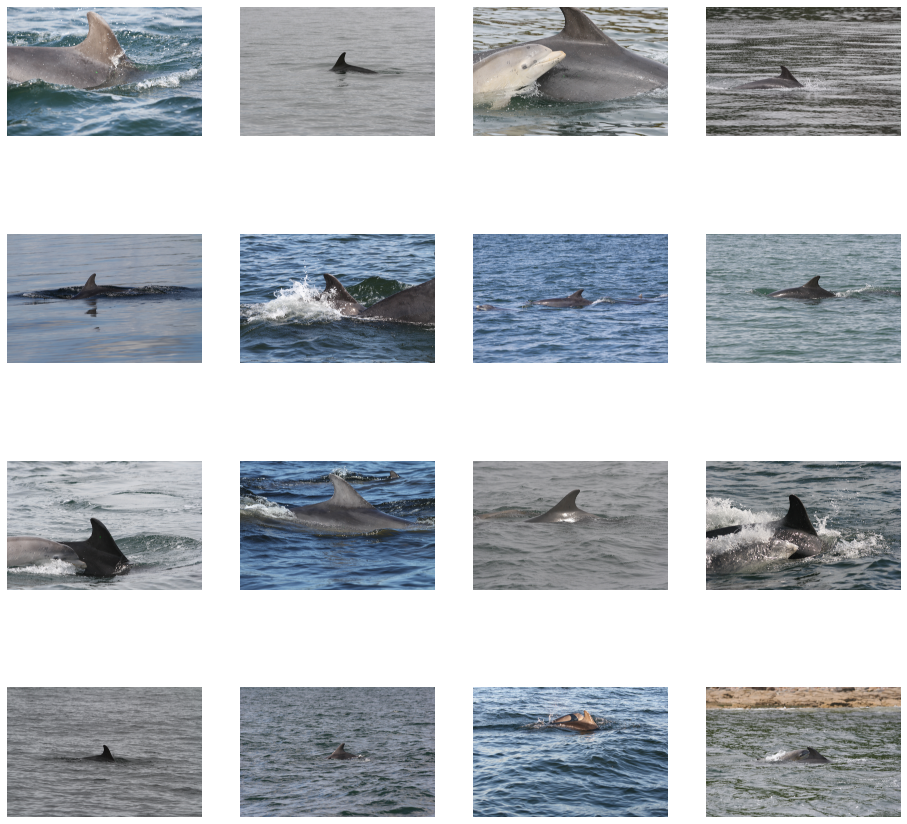

In [29]:
visualize_id(df, unique_ids[3])

In [56]:
def visualize_species(df, species) :
    data = df[df['species'] == species].copy()
    data.index = range(len(data.index))

    f, ax = plt.subplots(4,4, figsize = (16,16))
    print(species)
    for i in range(min(len(data.index), 16)) :
        imgfile = os.path.join(CONFIG['train_img_dir'], data.iloc[i]['image'])
        img = plt.imread(imgfile)
        ax[i//4, i%4].imshow(img)
        ax[i//4, i%4].set_title(df.iloc[i]['individual_id'])
        ax[i//4, i%4].axis('off')
    plt.show()


# unique species list

species_list = df.species.unique()
print('# of unique species: ', len(species_list))

# of unique species:  30


melon_headed_whale


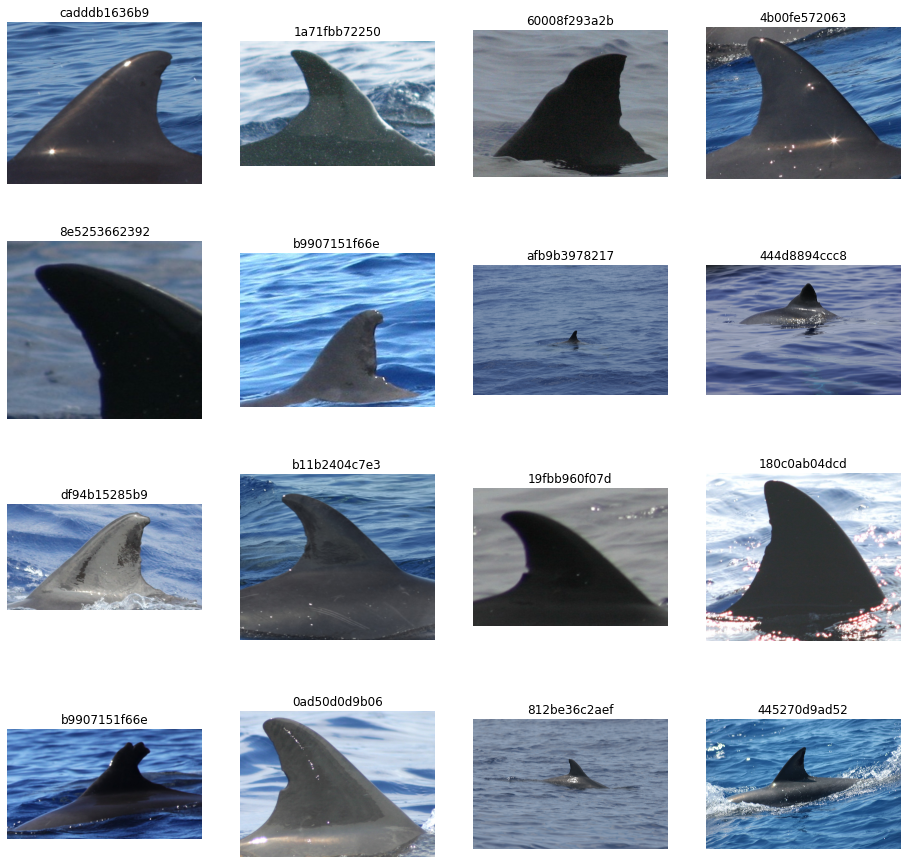

humpback_whale


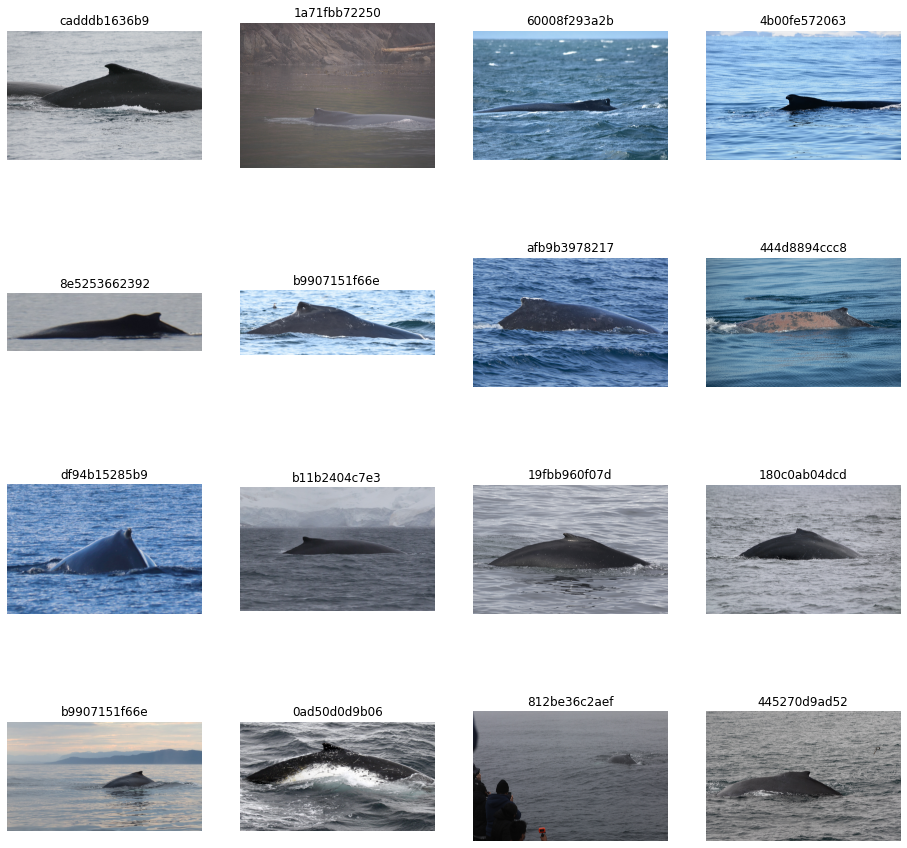

false_killer_whale


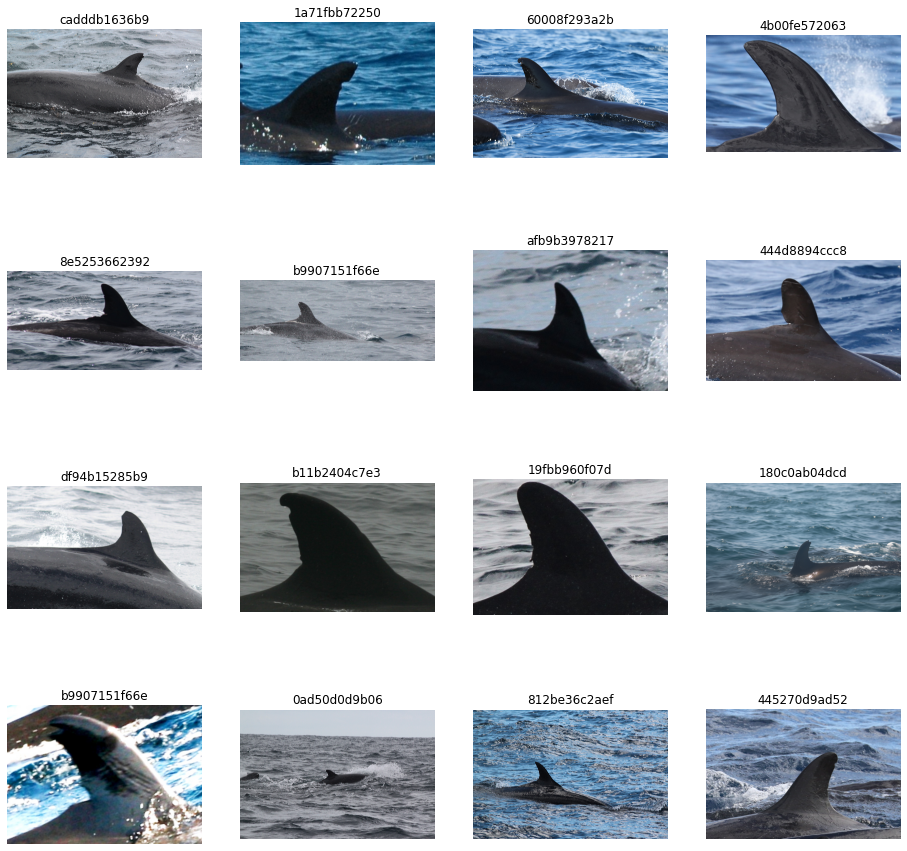

bottlenose_dolphin


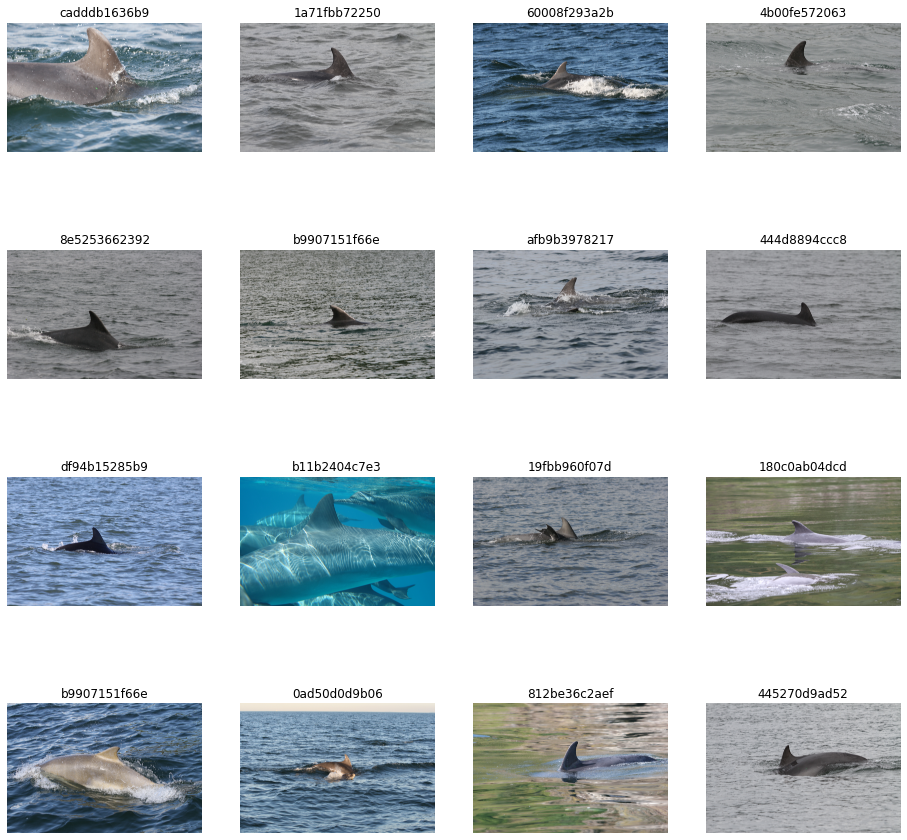

beluga


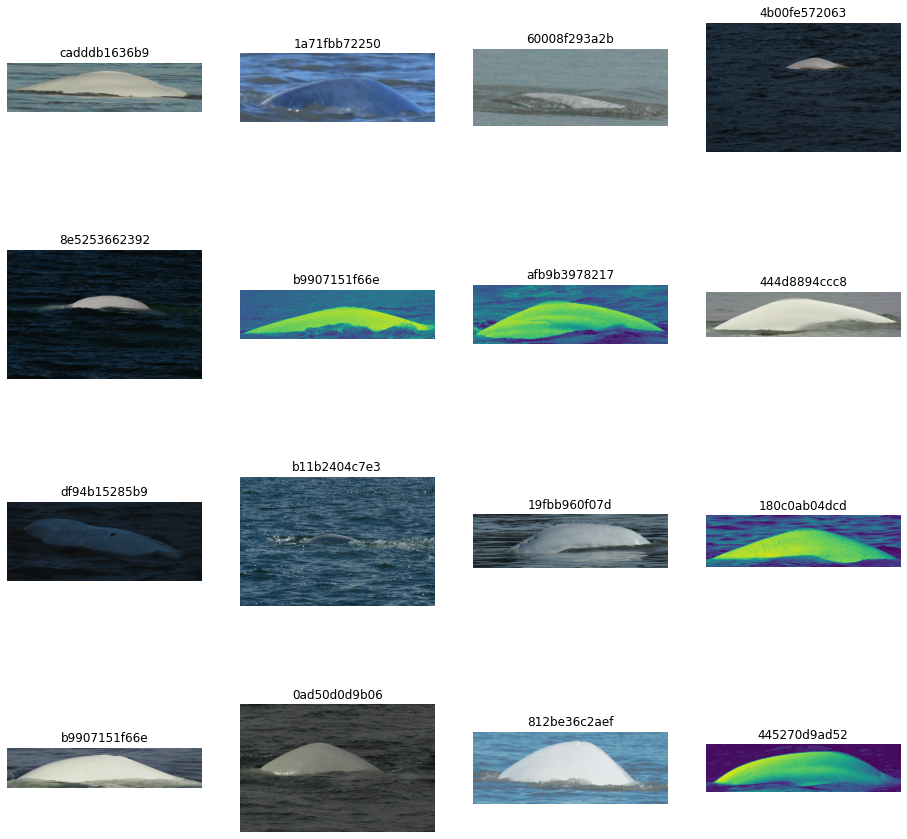

minke_whale


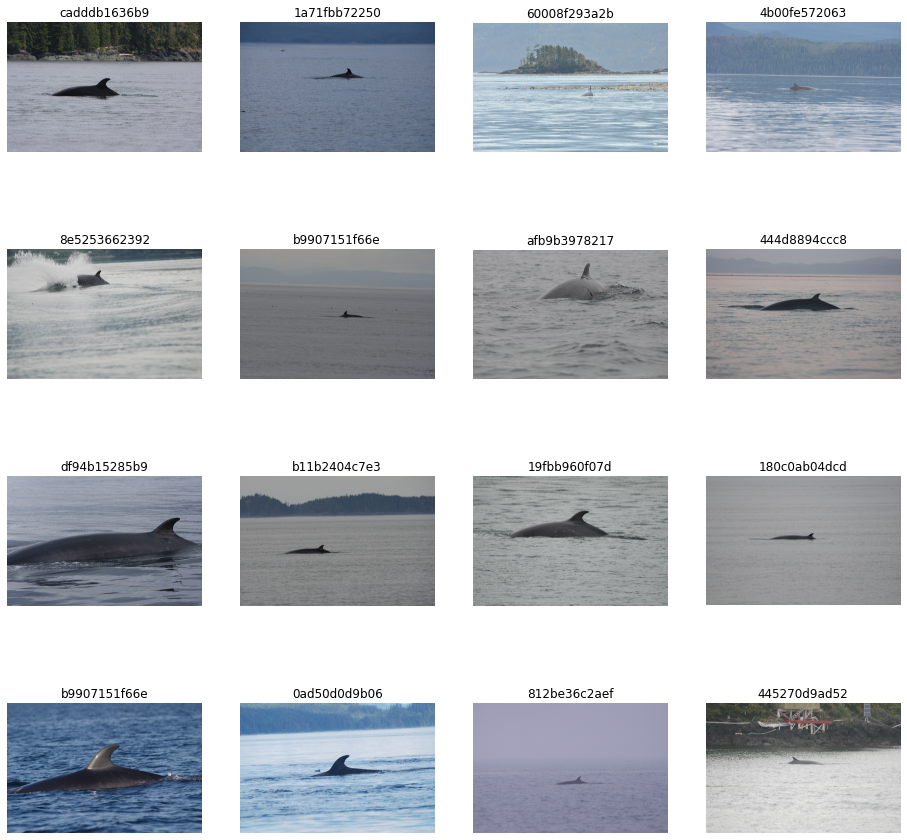

fin_whale


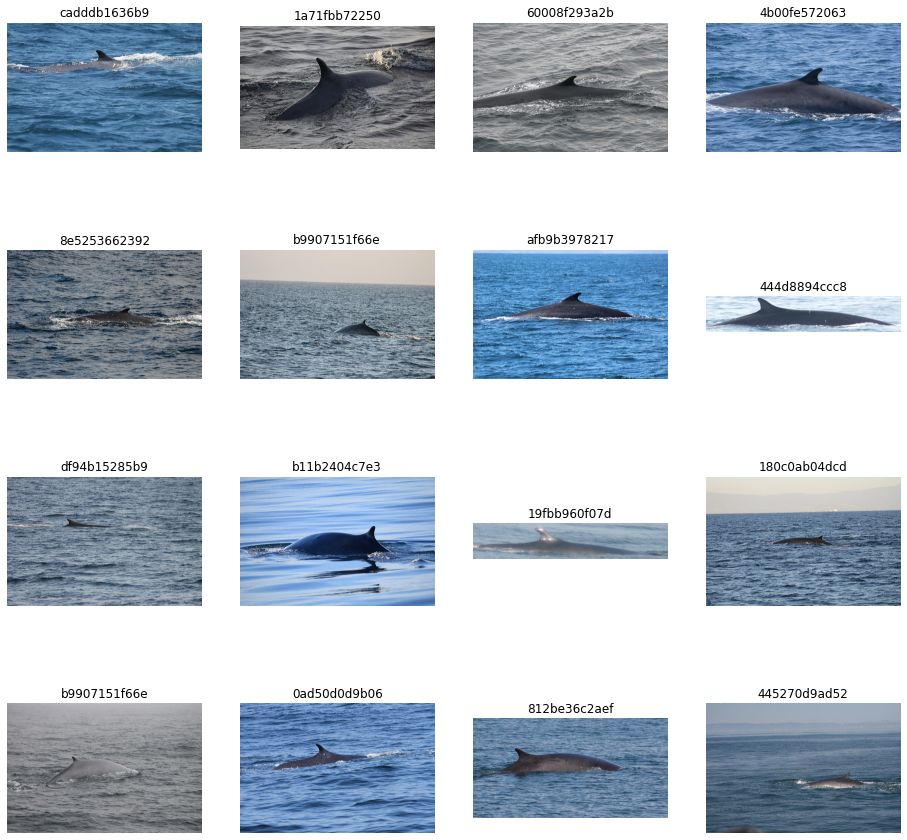

blue_whale


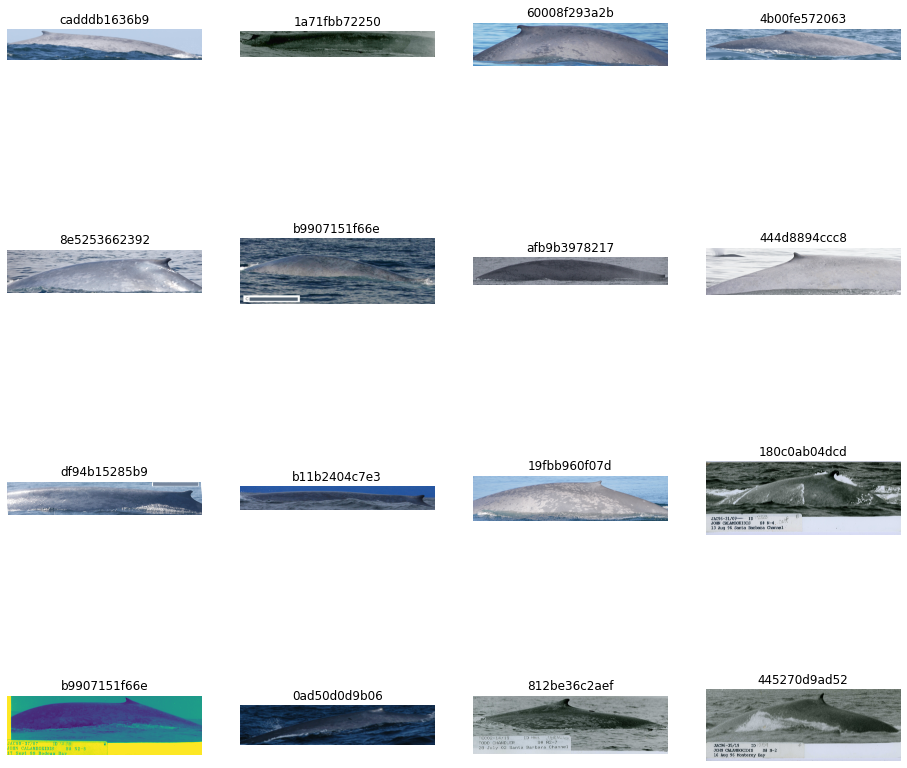

gray_whale


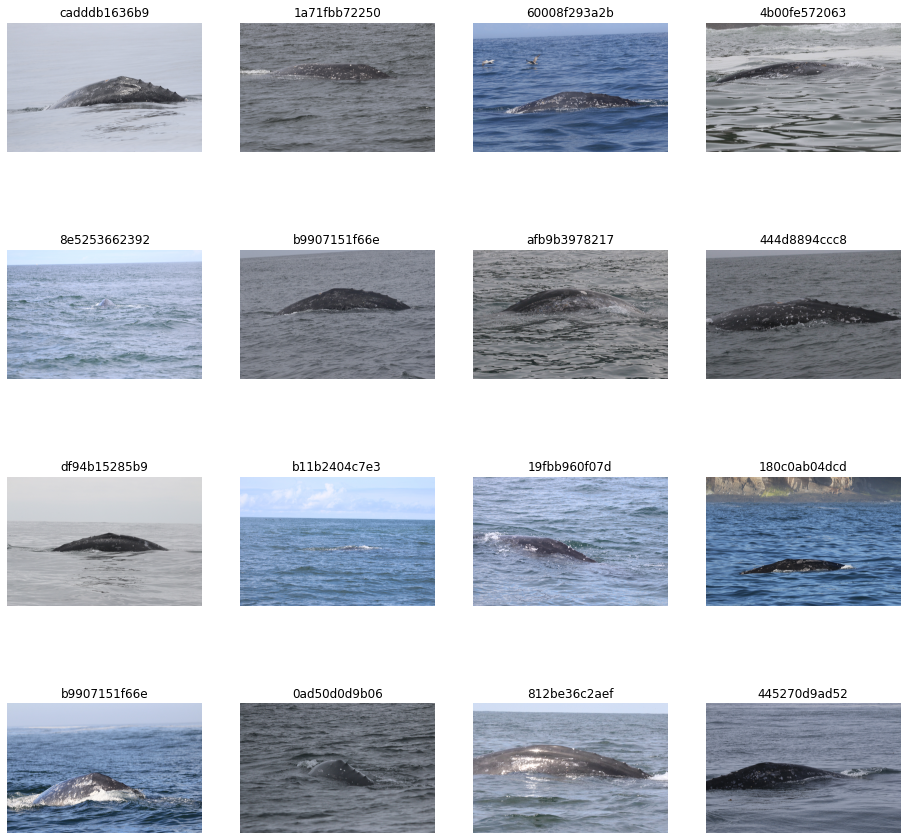

southern_right_whale


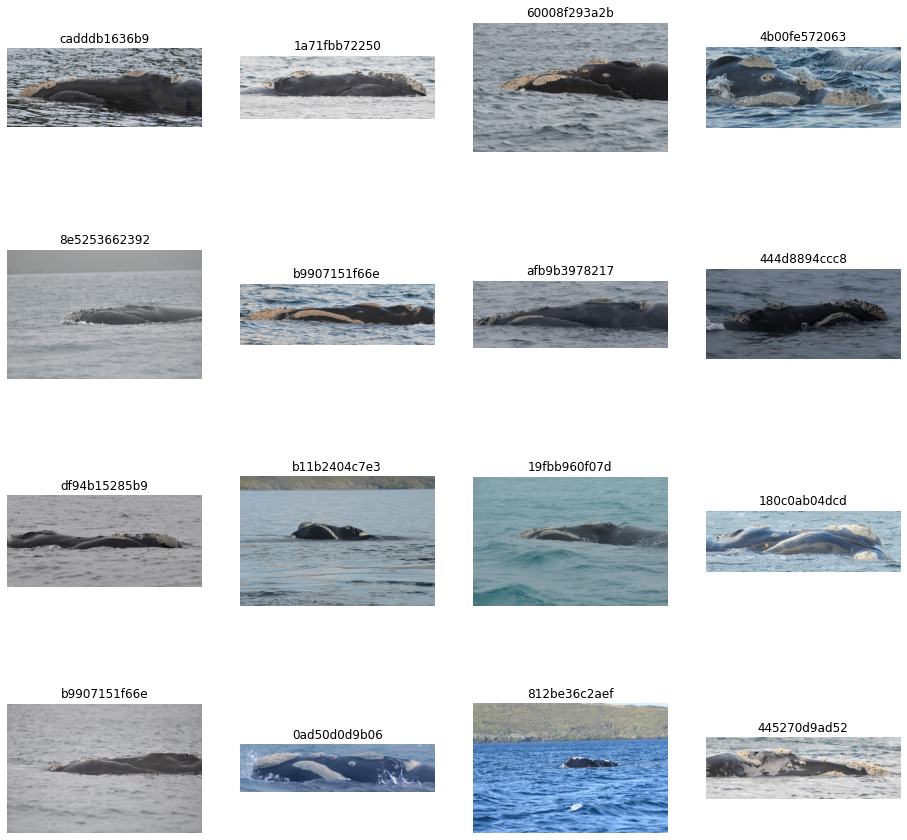

common_dolphin


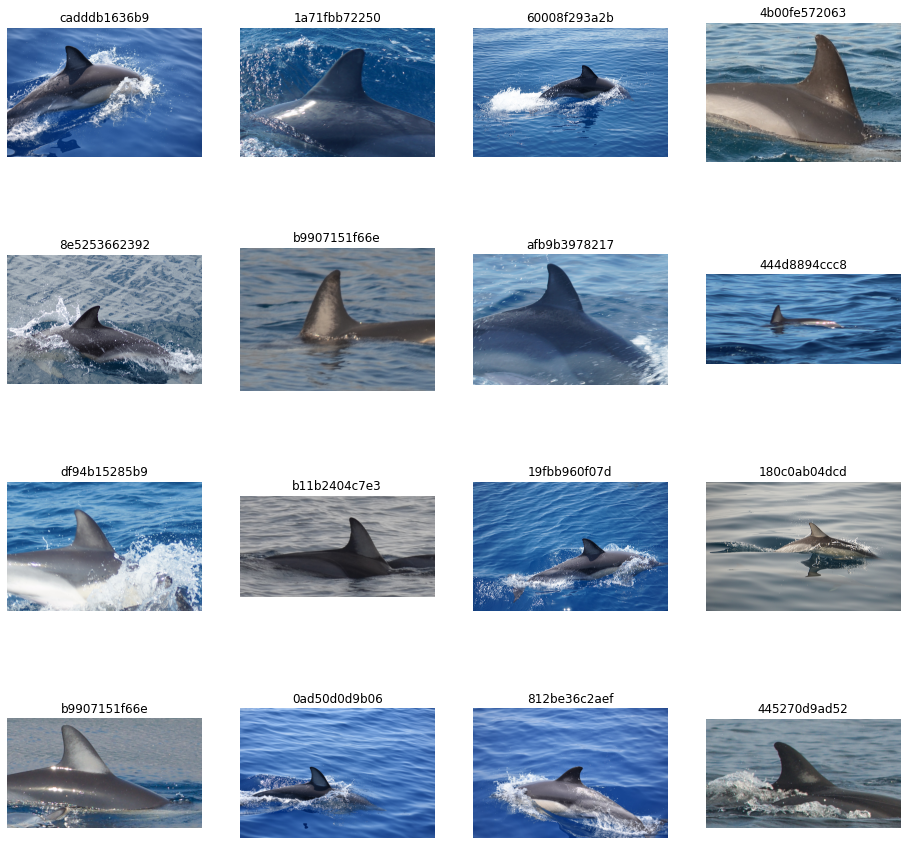

kiler_whale


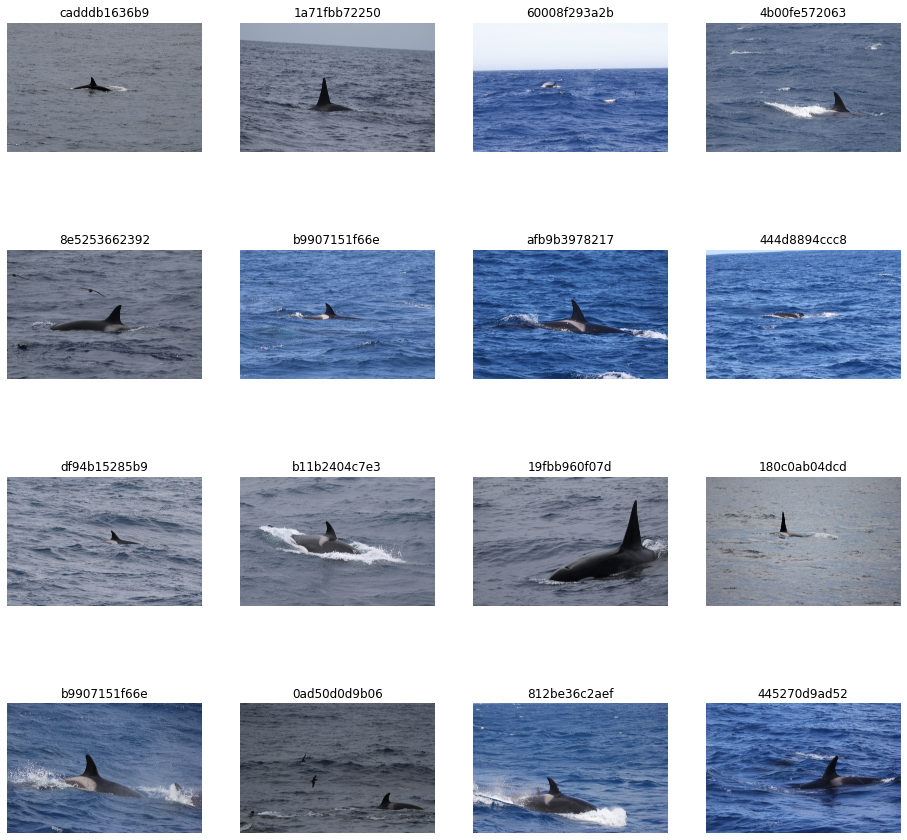

pilot_whale


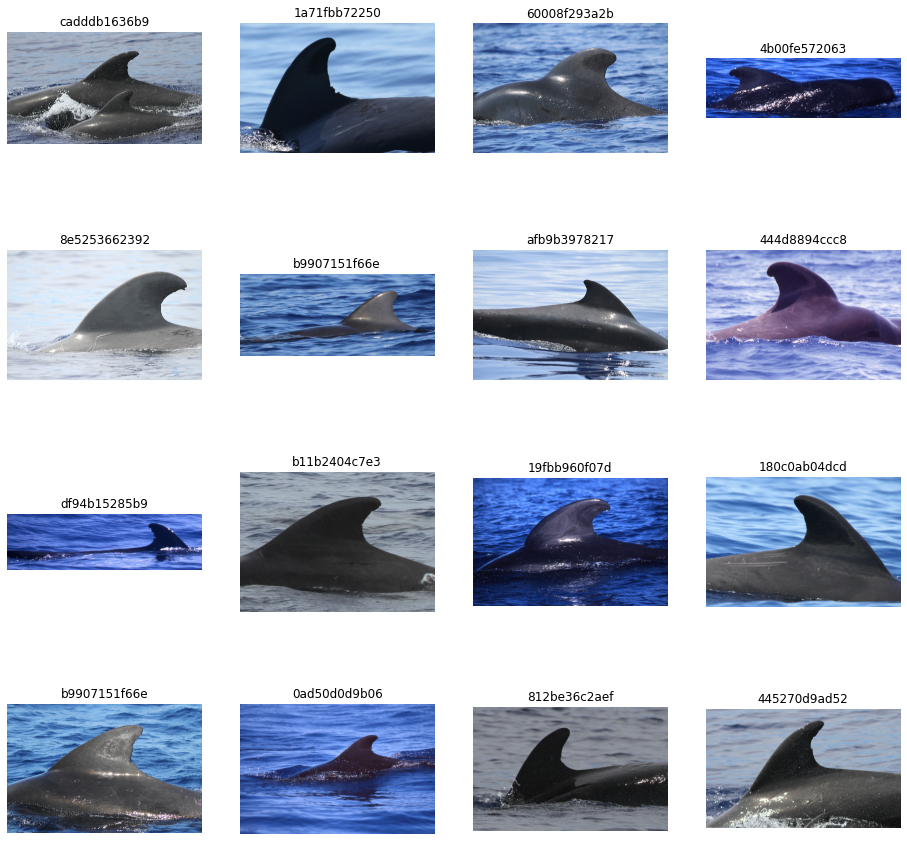

dusky_dolphin


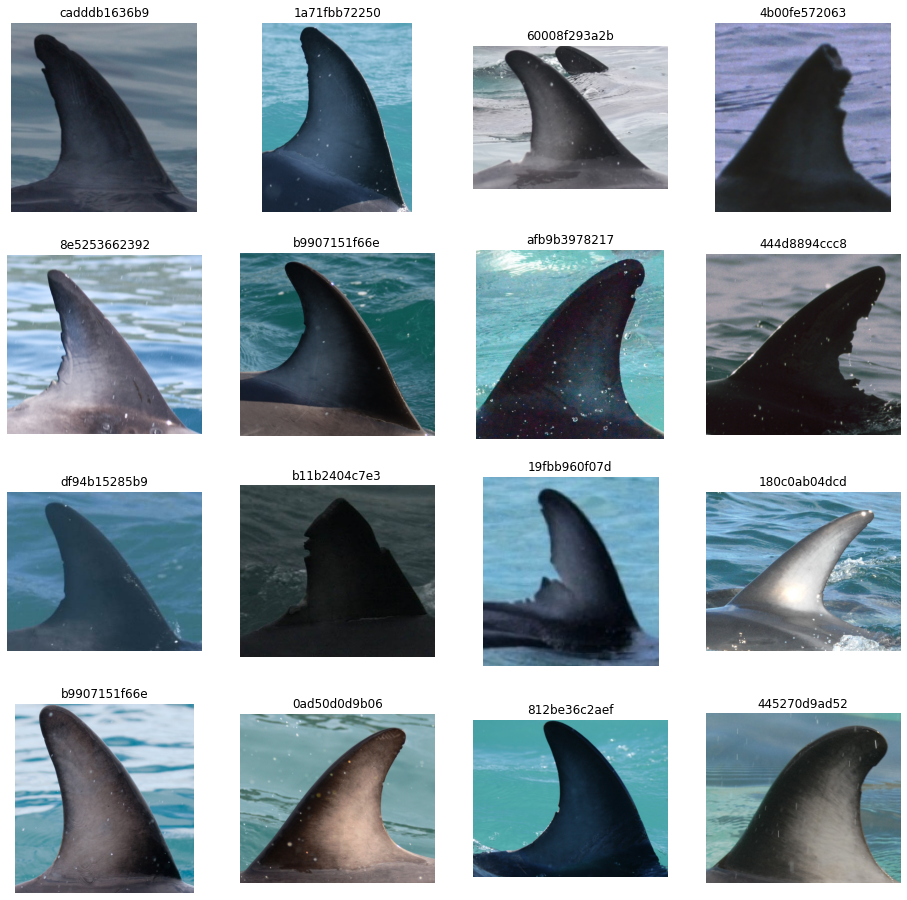

killer_whale


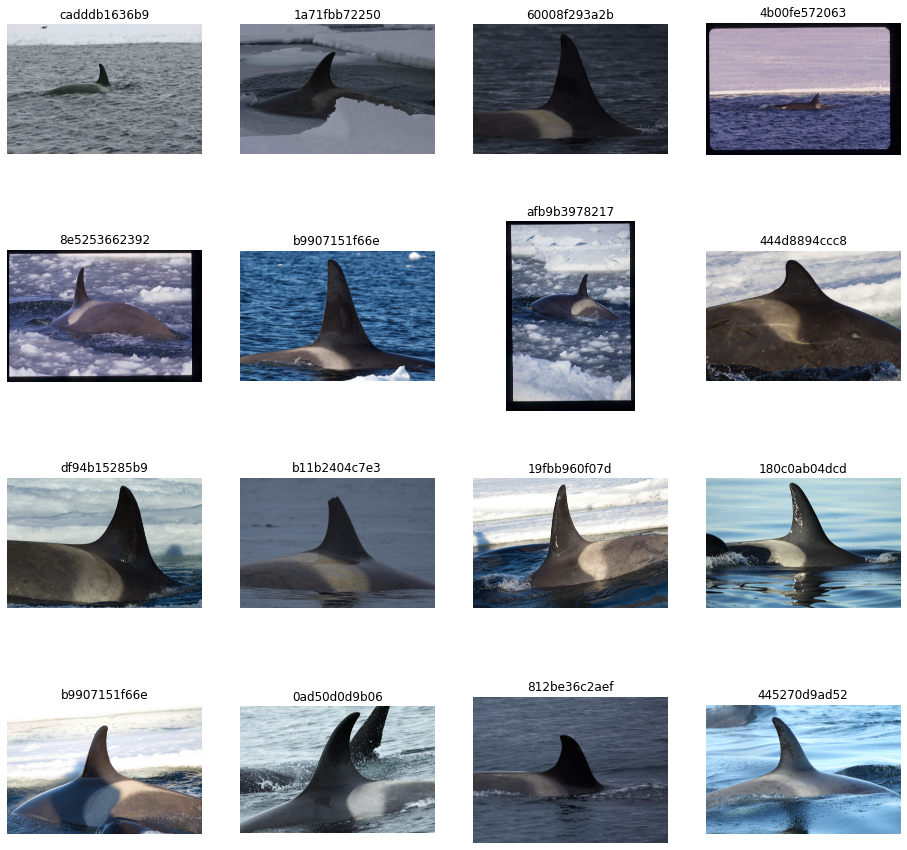

long_finned_pilot_whale


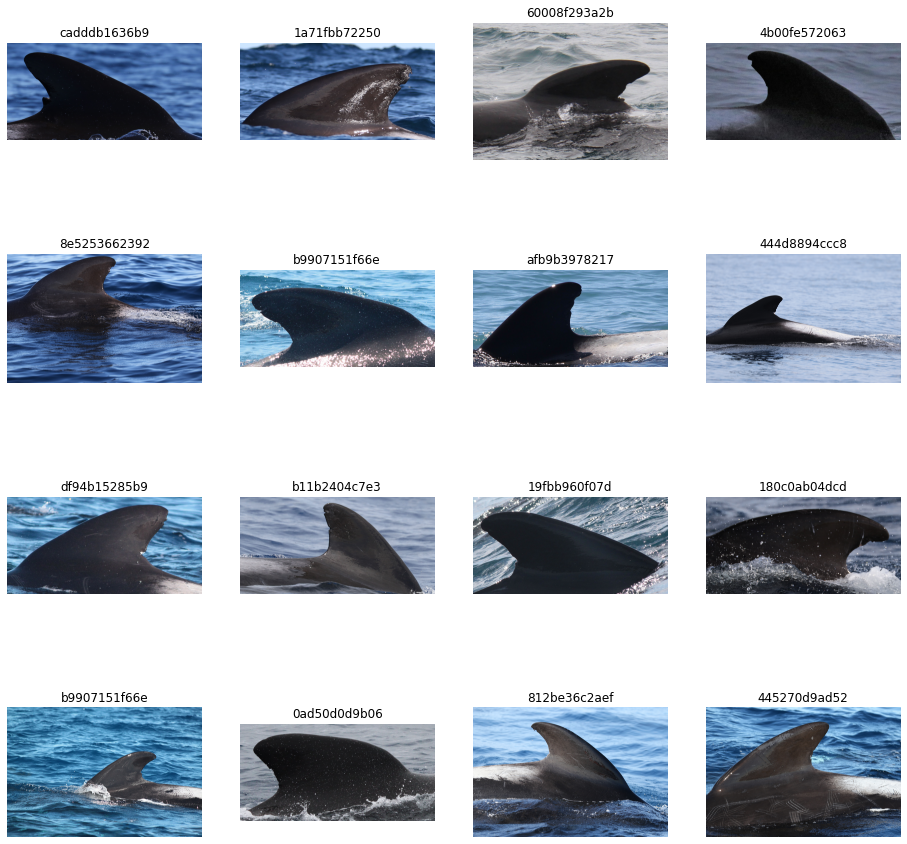

sei_whale


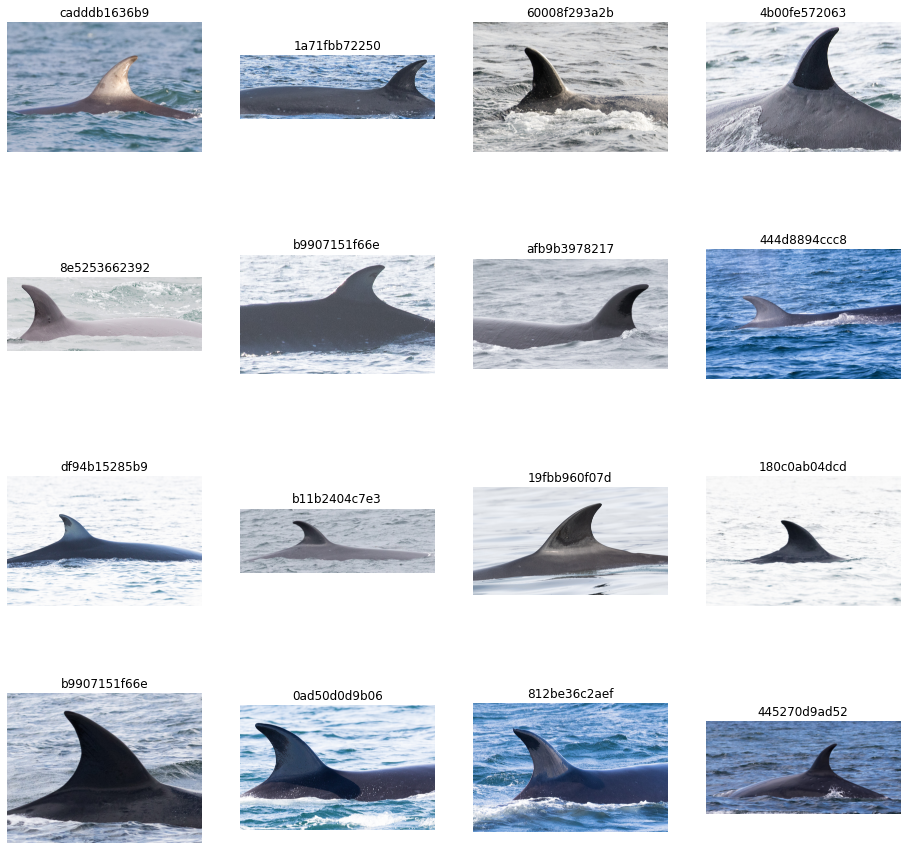

spinner_dolphin


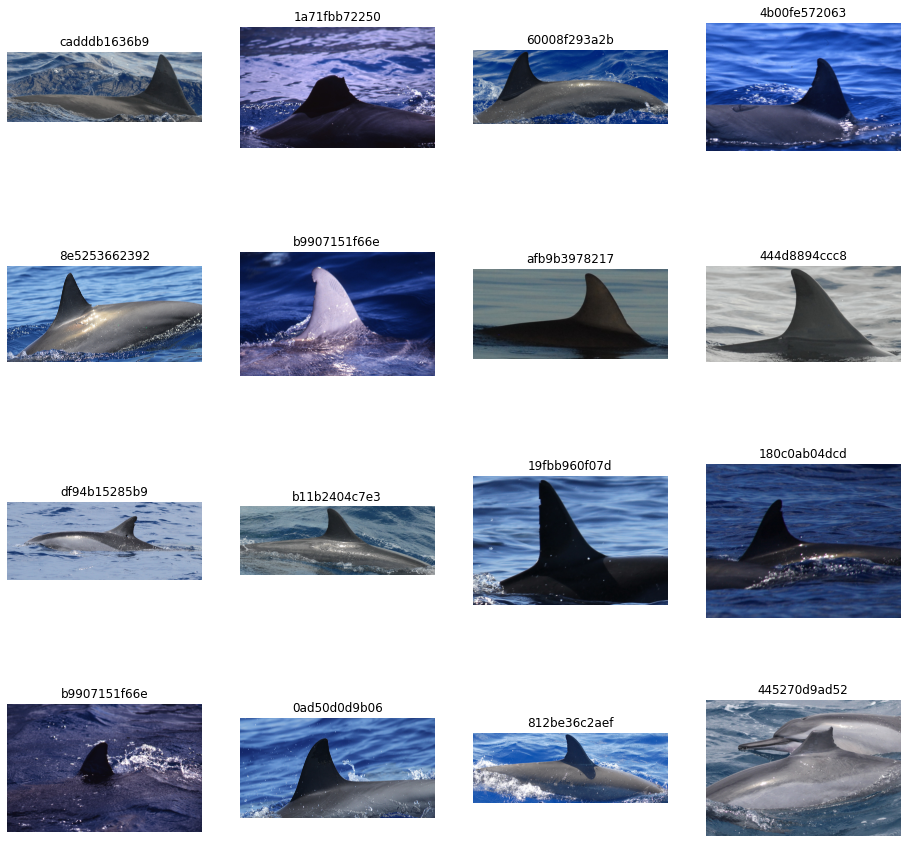

bottlenose_dolpin


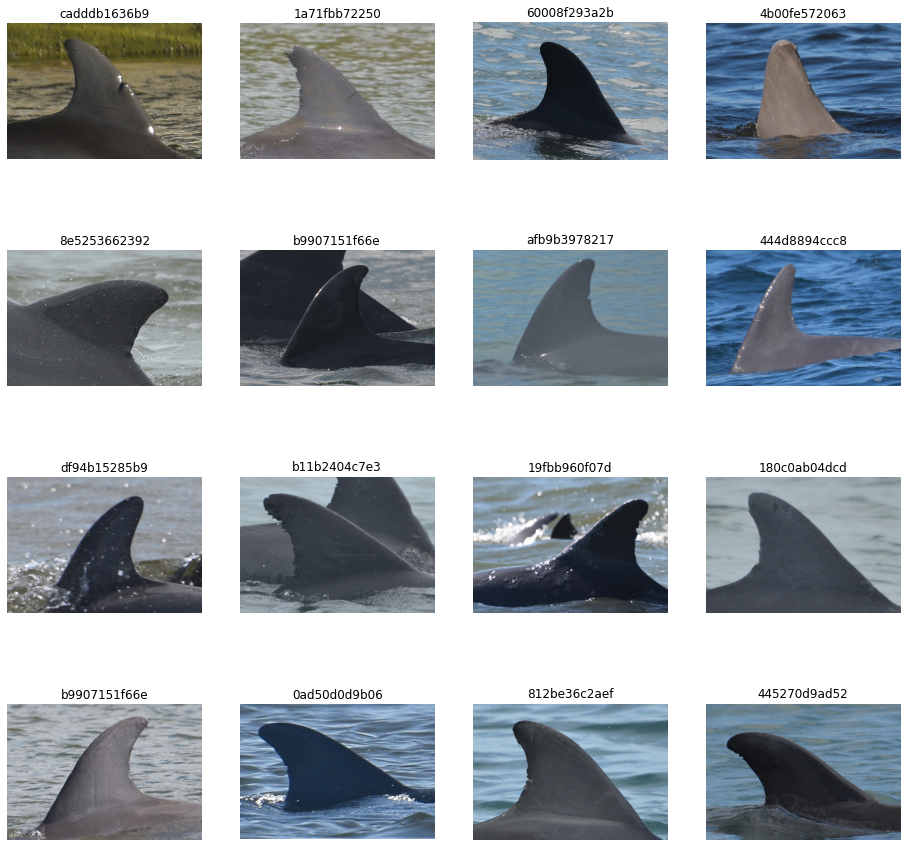

cuviers_beaked_whale


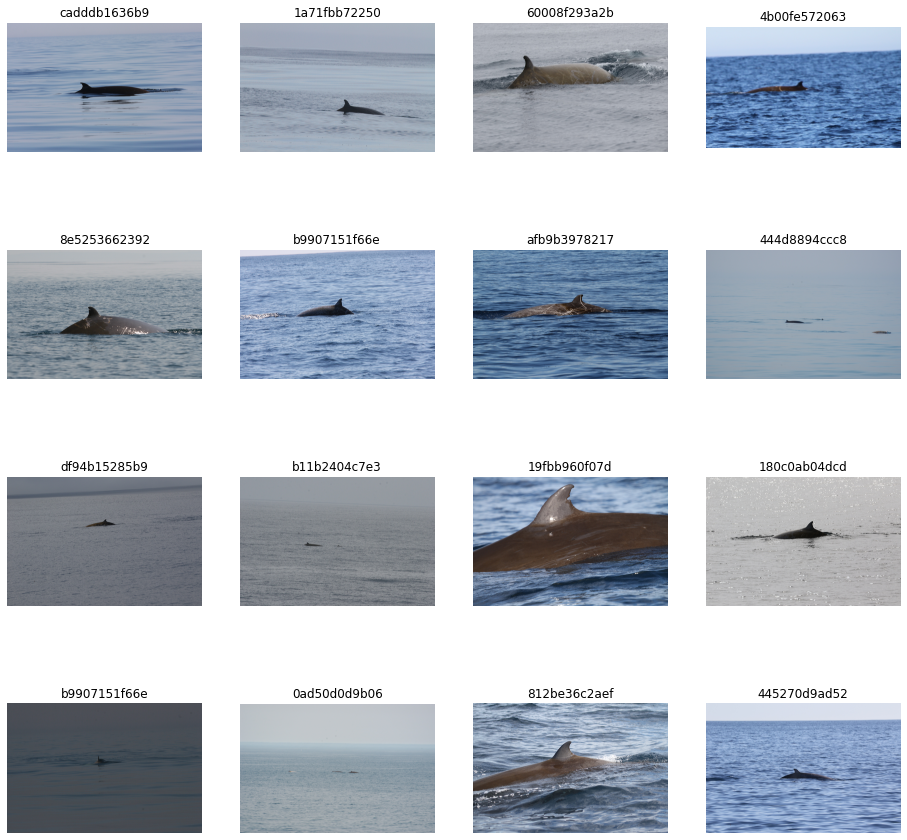

spotted_dolphin


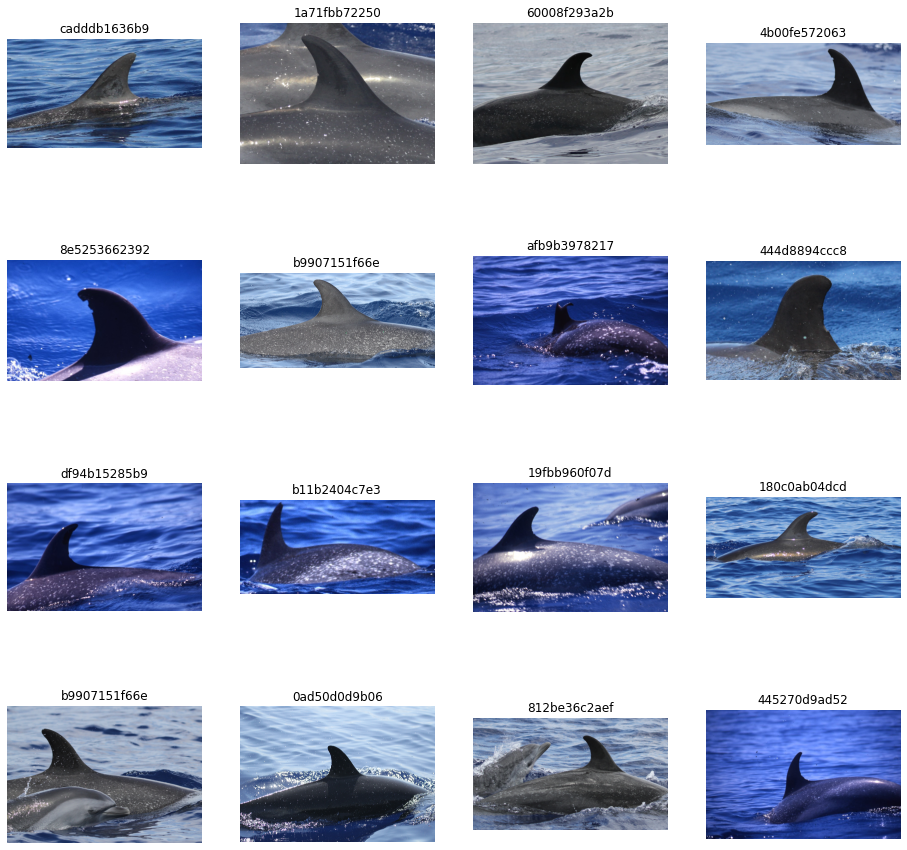

globis


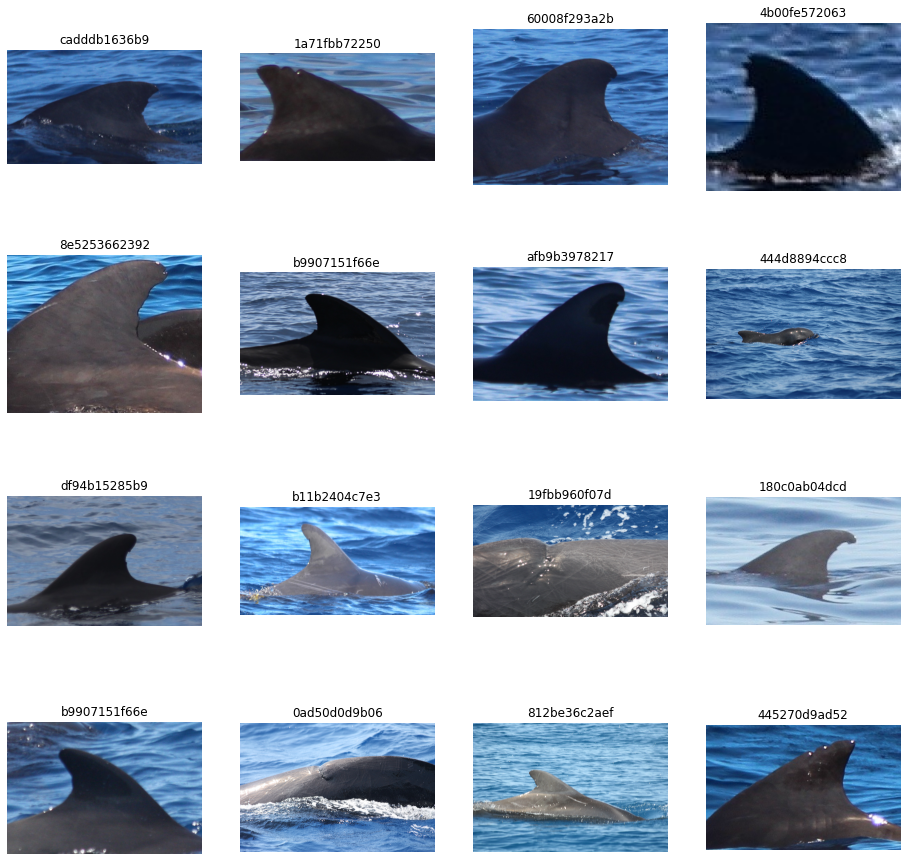

brydes_whale


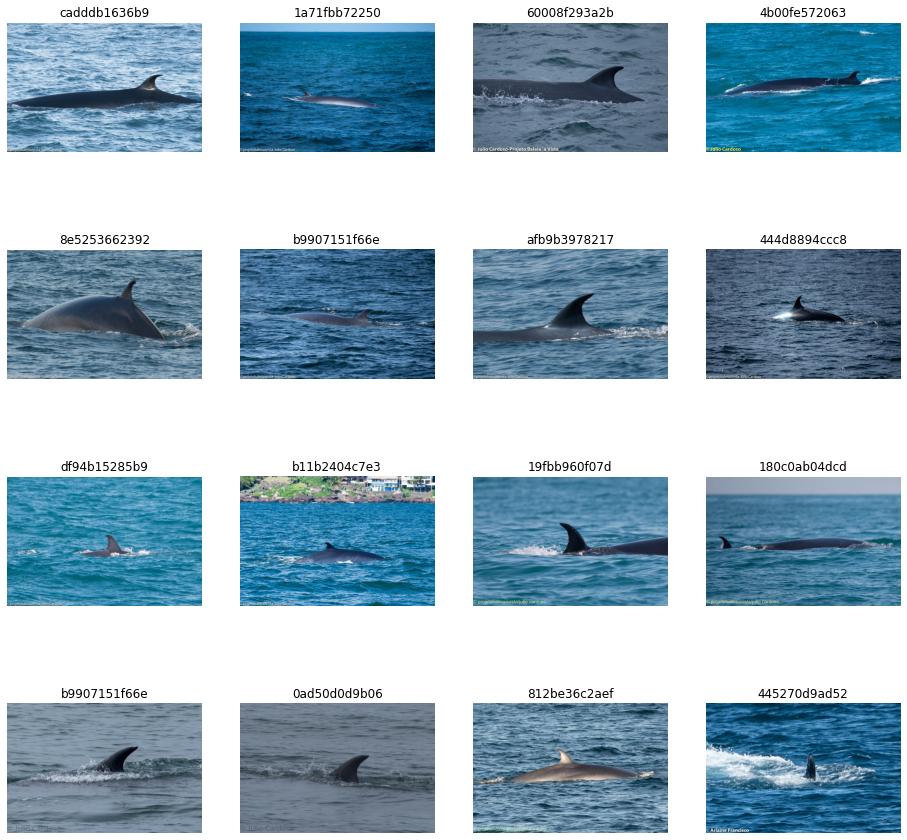

commersons_dolphin


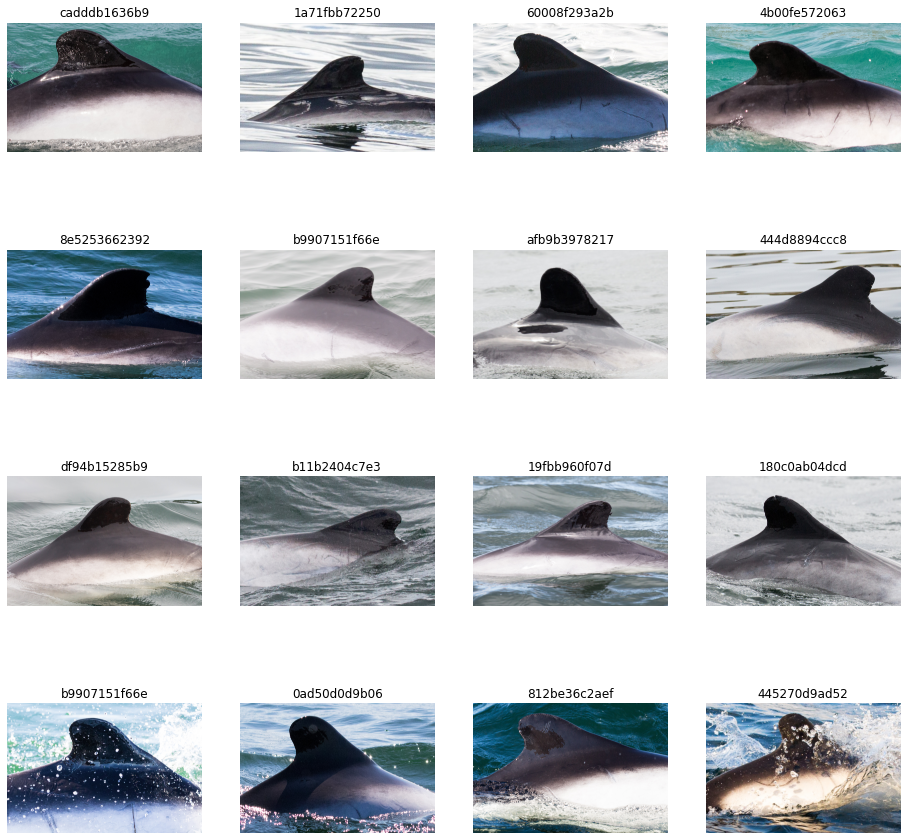

white_sided_dolphin


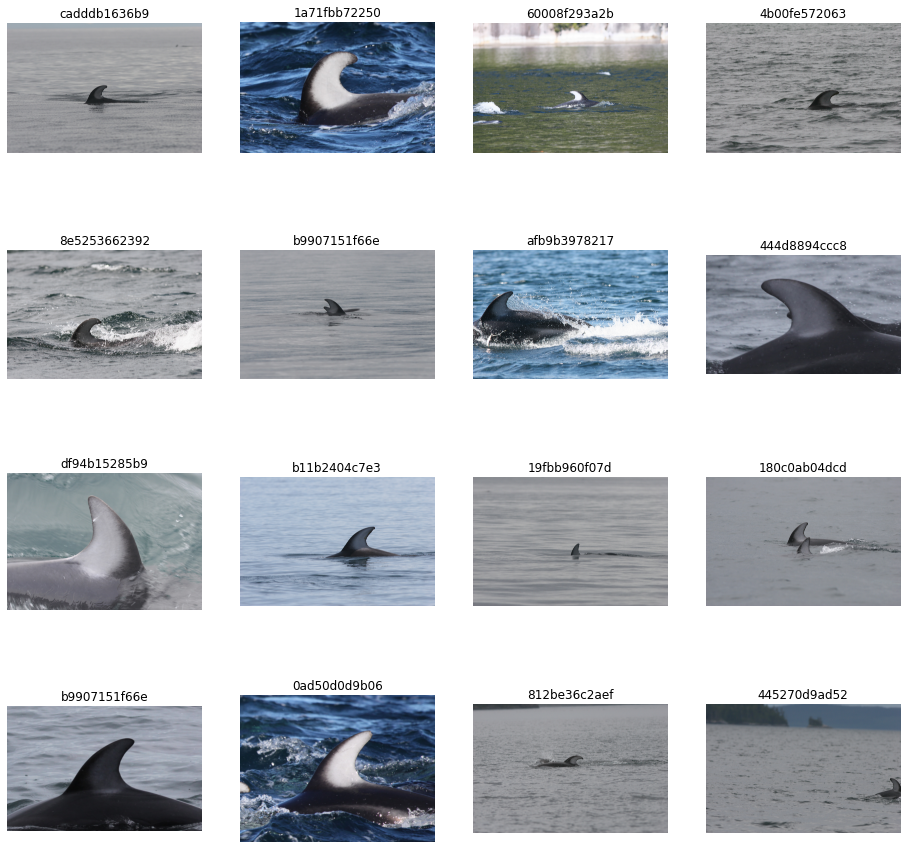

short_finned_pilot_whale


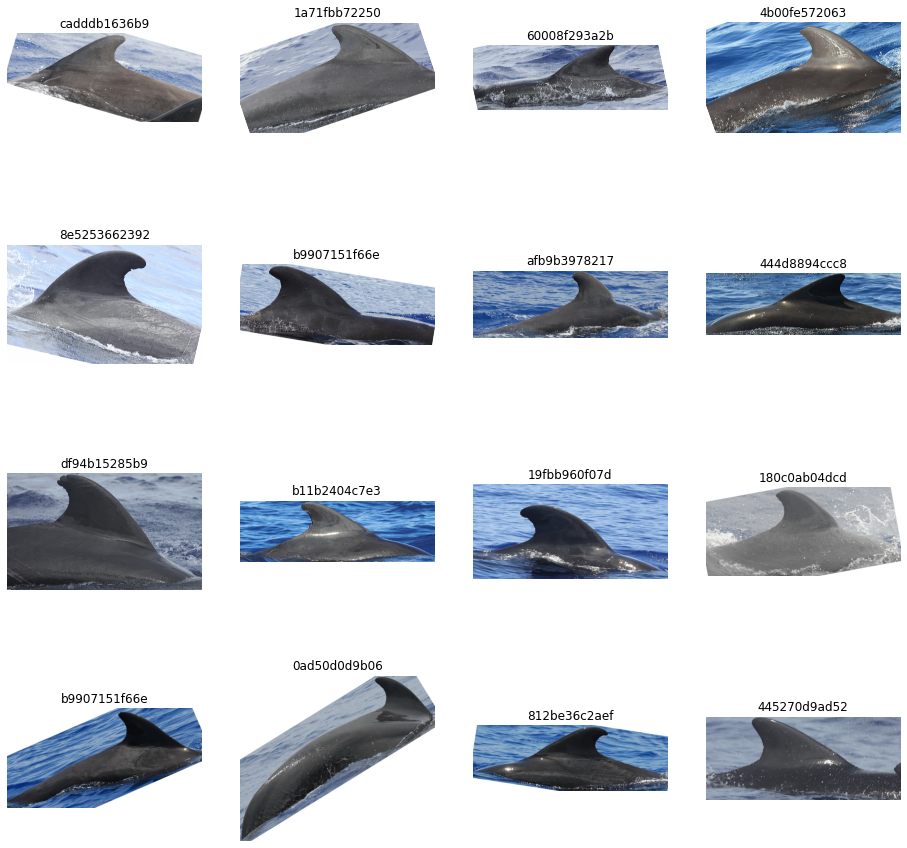

rough_toothed_dolphin


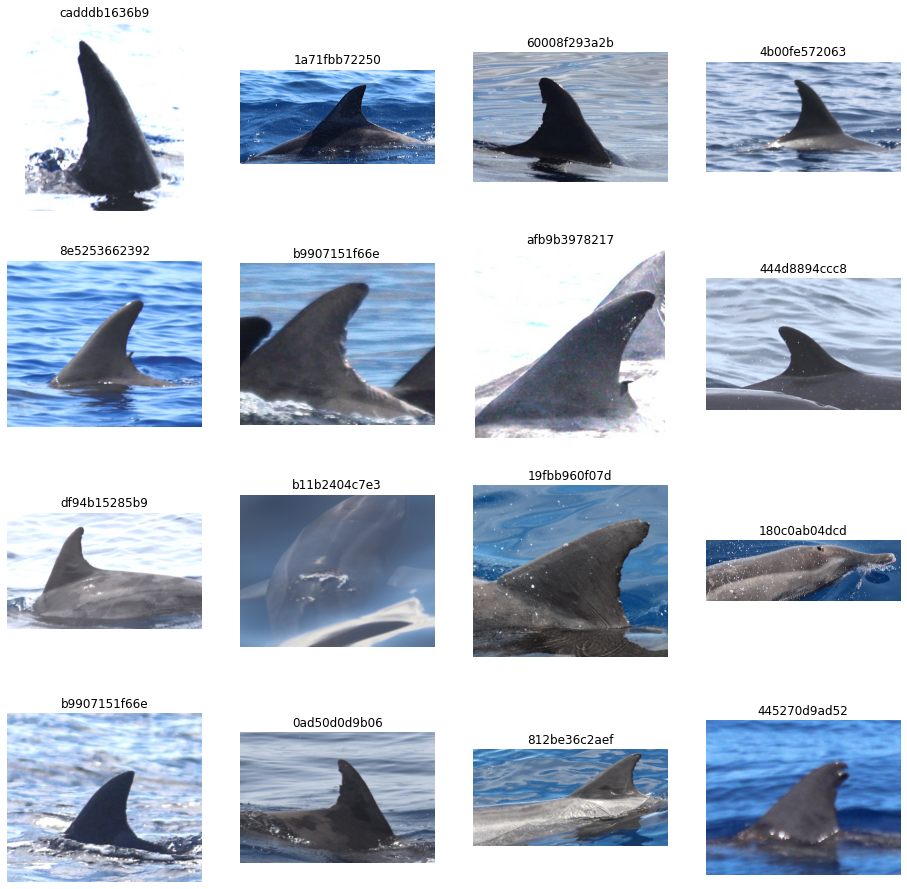

pantropic_spotted_dolphin


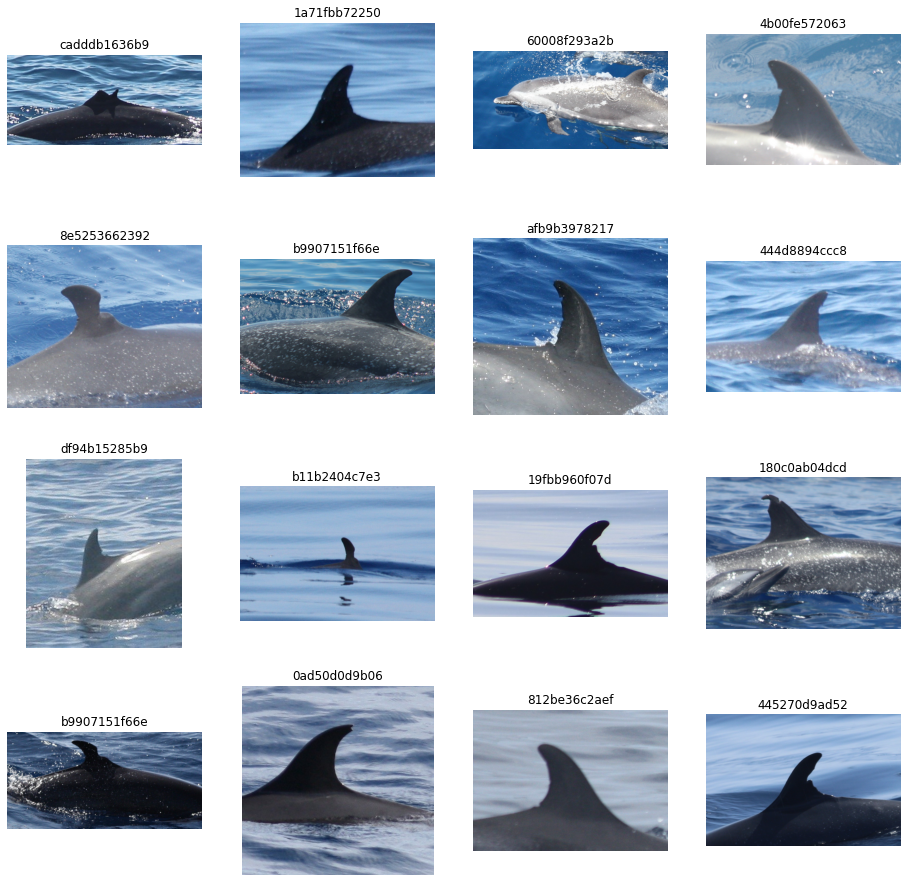

pygmy_killer_whale


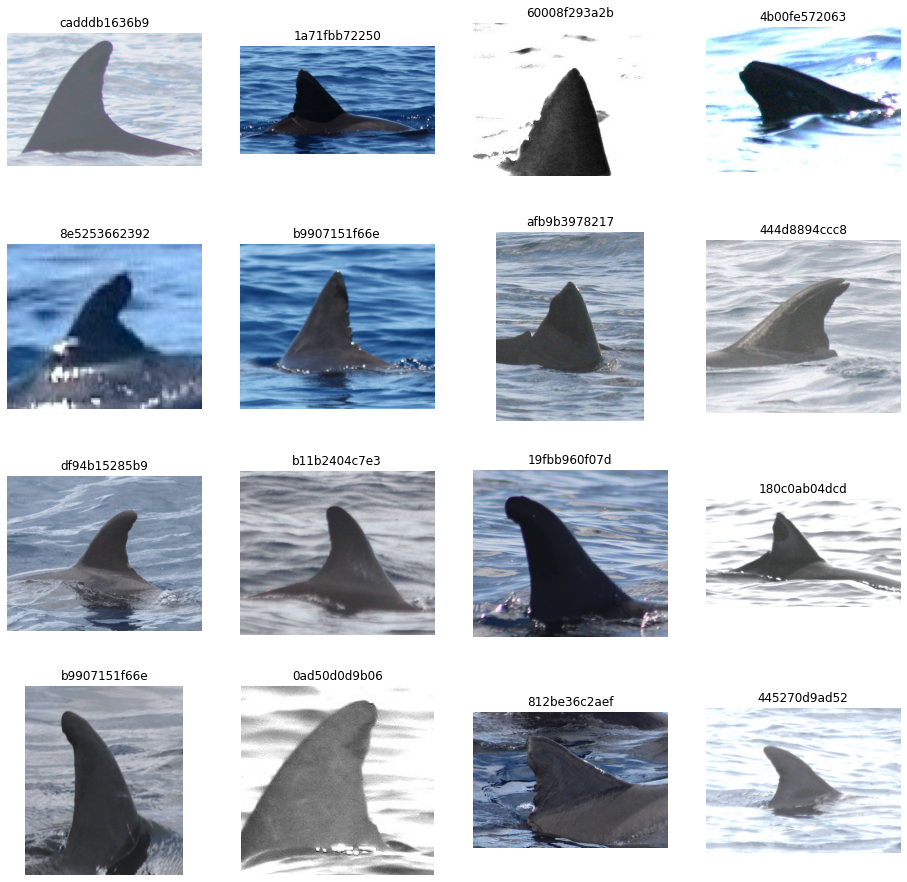

frasiers_dolphin


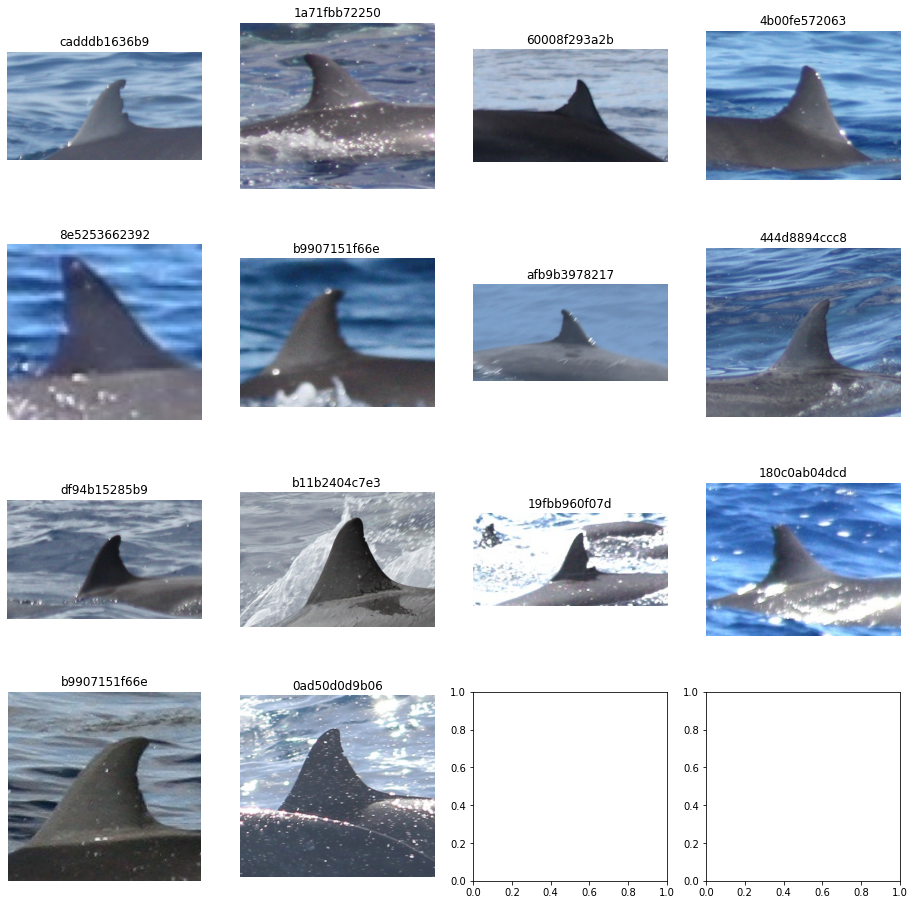

In [57]:
# visualize by species
# how species have similar points
for k in range(30) :
    visualize_species(df, species = species_list[k])

In [12]:
# 총 데이터가(train + test) 60GB로 굉장히 큰 편
import imagesize
from tqdm.notebook import tqdm

def get_imgsize(row) :
    row['width'], row['height'] = imagesize.get(os.path.join('train_images', row['image']))
    return row

tqdm.pandas(desc = 'train')
df = df.progress_apply(get_imgsize, axis = 1)

train:   0%|          | 0/51033 [00:00<?, ?it/s]

In [13]:
import plotly.express as px
data = df.species.value_counts().reset_index()
fig = px.bar(data, x='index', y='species', color='species',title='Species', text_auto=True)
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.show()


In [186]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from torchvision import datasets, transforms

# from pytorch_metric_learning import distances, losses, miners, reducers, testers
# from pytorch_metric_learning.utils.accuracy_calculator import AccuracyCalculator
import timm

## Dataset

In [187]:
# make fold
from sklearn.model_selection import GroupKFold

gkf = GroupKFold(n_splits = CONFIG['n_fold'])

for fold, (_, val_) in enumerate(gkf.split(X = df, y = df.individual_id, groups = df.individual_id)) :
    df.loc[val_, 'kfold'] = fold

In [94]:
df.kfold.value_counts()

2.0    10207
0.0    10207
1.0    10207
4.0    10206
3.0    10206
Name: kfold, dtype: int64

In [223]:
# Dataset Class
from torch.utils.data import Dataset
class HappyWhaleDataset(Dataset) :
    def __init__(self, df, transforms = None) : 
        self.df = df
        self.groups = df.groupby('individual_id').groups
        self.keys = list(self.groups.keys())
        self.transforms = transforms

    def __len__(self) :
        return len(self.groups)
    
    def __getitem__(self, index) :
        image_indices_1 = self.groups[self.keys[index]]
        image_path_1 = self.df.iloc[image_indices_1, :].sample(n = 1)['image'].values[0]
        
        image_1 = cv2.cvtColor(cv2.imread(image_path_1), cv2.COLOR_BGR2RGB)
        individual_id_1 = self.df.iloc[image_indices_1, :]['individual_id'].values[0]

        image_index_2 = self.df.sample(n=1).index
        image_path_2 = self.df.iloc[image_index_2, :]['image'].values[0]
        image_2 = cv2.cvtColor(cv2.imread(image_path_2), cv2.COLOR_BGR2RGB)
        individual_id_2 = self.df.iloc[image_index_2,:]['individual_id'].values[0]

        target = 1 if individual_id_1 == individual_id_2 else -1

        if self.transforms :
            image_1 = self.transforms(image = image_1)['image']
            image_2 = self.transforms(image = image_2)['image']

        return {
            'image1' : image_1,
            'image2' : image_2,
            'target' : torch.tensor(target, dtype = torch.long) 
        }






In [224]:
# augmentation
import albumentations as A
from albumentations.pytorch import ToTensorV2

data_transforms = {
    'train' : A.Compose(
        [
            A.Resize(CONFIG['img_size'], CONFIG['img_size']),
            A.HorizontalFlip(0.5),
            A.VerticalFlip(0.5),
            A.Normalize(
                mean = [0.485, 0.456, 0.406],
                std = [0.229, 0.224, 0.225],
                max_pixel_value = 255.0,
                p = 1.0
            ),
            ToTensorV2()], p=1.),

    'valid' : A.Compose(
        [
            A.Resize(CONFIG['img_size'], CONFIG['img_size']),
            A.Normalize(
                mean = [0.485, 0.456, 0.406],
                std = [0.229, 0.224, 0.225],
                max_pixel_value = 255.0,
                p = 1.0
            ),
            ToTensorV2()], p=1.)
}

## model

In [167]:
# timm 모델 사용해서, feature extractor 만들기

# print(timm.list_models())

class GeM(nn.Module) :
    def __init__(self, p = 3, eps=1e-6) :
        super(GeM, self).__init__()
        self.p = nn.Parameter(torch.ones(1) *p)
        self.eps = eps

    def forward(self, x) :
        return self.gem(x, p = self.p, eps = self.eps)

    def gem(self, x, p = 3, eps = 1e-6) :
        return F.avg_pool2d(x.clamp(min = eps).pow(p), (x.size(-2), x.size(-1))).pow(1./p)

    def __repr__(self) :
        return self.__class__.__name__ + '(' + 'p=' + ':.4f'.format(self.p.data.tolist()[0]) + ', ' + 'eps=' + str(self.eps) + ')'



class HappyWhaleModel(nn.Module) :
    '''Siamese Network'''

    def __init__(self, model_name, pretrained = True) :
        super().__init__()
        self.base_model = timm.create_model(model_name, pretrained = pretrained, num_classes = 0)
        self.fc = nn.LazyLinear(CONFIG['embedding_size']) # interchangable with nn.Identity
        self.dropout = nn.Dropout(p = 0.3)

    def forward(self, images) :
        features = self.base_model(images)
        features = self.dropout(features)
        output = self.fc(features)
        return output

model = HappyWhaleModel(CONFIG['model_name'])
model.to(CONFIG['device'])



/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/torch/nn/modules/lazy.py:178: UserWarning:

Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.



HappyWhaleModel(
  (base_model): EfficientNet(
    (conv_stem): Conv2dSame(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn1): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (act1): SiLU(inplace=True)
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
          (act1): SiLU(inplace=True)
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (act1): SiLU(inplace=True)
            (conv_expand): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (gate): Sigmoid()
          )
          (conv_pw): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(16, eps=0.001, momentum=0.1, affine=True, t

In [168]:
img = torch.randn(1, 3, CONFIG['img_size'], CONFIG['img_size']).to(CONFIG['device'])
model(img).shape

torch.Size([1, 256])

In [169]:
## loss function
def criterion(outputs1, outputs2, targets) :
    return nn.CosineEmbeddingLoss(margin=CONFIG['margin'])(outputs1, outputs2, targets)

In [230]:
def train_one_epoch(model, optimizer, scheduler, dataloader, device, epoch) :
    model.train()

    dataset_size = 0
    running_loss = 0.0

    bar = tqdm(enumerate(dataloader), total = len(dataloader))
    for step, data in bar :
        images1 = data['image1'].to(device, dtype = torch.float)
        images2 = data['image2'].to(device, dtype = torch.float)
        targets = data['target'].to(device, dtype = torch.long)

        batch_size = images1.size(0)

        outputs1 = model(images1)
        outputs2 = model(images2)

        loss = criterion(outputs1, outputs2, targets)
        loss = loss / CONFIG['n_accumulate']
        loss.backward()

        if (step + 1) % CONFIG['n_accumulate'] == 0 : # lazy linear 때문에?
            optimizer.step()

            # zero the parameter gradients
            optimizer.zero_grad()

            if scheduler is not None :
                scheduler.step()

        running_loss += (loss.item() * batch_size)
        dataset_size += batch_size

        epoch_loss = running_loss / dataset_size

        bar.set_postfix(Epoch = epoch, Train_Loss = epoch_loss, \
                            LR = optimizer.param_groups[0]['lr'])

    gc.collect() # garbage collection

    return epoch_loss
            




In [231]:
@torch.inference_mode()
def valid_one_epoch(model, dataloader, device, epoch) :
    model.eval()

    dataset_size = 0
    running_loss = 0.0

    bar = tqdm(enumerate(dataloader), total=len(dataloader))
    for step, data in bar :
        images1 = data['image1'].to(device, dtype = torch.float)
        images2 = data['image2'].to(device, dtype = torch.float)
        targets = data['target'].to(device, dtype = torch.long)

        batch_size = images1.size(0)

        outputs1 = model(images1)
        outputs2 = model(images2)
        loss = criterion(outputs1, outputs2, targets)

        running_loss += (loss.item() * batch_size)
        dataset_size += batch_size

        epoch_loss = running_loss / dataset_size

        bar.set_postfix(Epoch = epoch, Valid_Loss = epoch_loss, \
                        LR = optimizer.param_groups[0]['lr'])

    gc.collect()

    return epoch_loss


In [232]:
def run_training(model, optimizer, scheduler, device, num_epochs) :

    wandb.watch(model, log_freq = 100)

    if torch.cuda.is_available() :
        print('[INFO] Using GPU: {}\n'.format(torch.cuda.get_Device_name()))

    start = time.time()
    best_model_wts = copy.deepcopy(model.state_dict())
    best_epoch_loss = np.inf
    history = defaultdict(list)

    for epoch in range(1, num_epochs + 1) :
        gc.collect()
        train_epoch_loss = train_one_epoch(model, optimizer, scheduler, dataloader = train_loader,\
                                            device = CONFIG['device'], epoch = epoch)

        val_epoch_loss = valid_one_epoch(model, valid_loader, device = CONFIG['device'], epoch = epoch)

        history['Train Loss'].append(train_epoch_loss)
        history['Valid Loss'].append(val_epoch_loss)

        # log the metrics
        wandb.log({'Train Loss' : train_epoch_loss})
        wandb.log({'Valid Loss' : val_epoch_loss})

        # deep copy the model
        if val_epoch_loss <= best_epoch_loss :
            run.summary['Best Loss'] = best_epoch_loss
            best_model_wts = copy.deepcopy(model.state_dict())
            PATH = 'Loss{:.4f}_epoch{:.0f}.bin'.format(best_epoch_loss, epoch)

            torch.save(model.state_dict(), PATH)
            # Save a model file from the current directory
            print(f'Model Saved {sr_}')

        print()

    end = time.time()
    time_elapsed = end - start
    print('Training complete in {:.0f}h {:.0f}m {:.0f}s'.format(
        time_elapsed // 3600, (time_elapsed % 3600) //60, (time_elapsed %3600) % 60
    ))
    print('Best Loss : {:.4f}'.format(best_epoch_loss))

    # load best model weights
    model.load_state_dict(best_model_wts)

    return model, history

In [233]:
def fetch_scheduler(optimizer) :
    if CONFIG['scheduler'] == 'CosineAnnealingLR' :
        scheduler = lr_scheduler.CosineAnnealingLR(optimizer, T_max=CONFIG['T_max'], eta_min = CONFIG['min_lr']
        )
    elif CONFIG['scheduler'] == 'CosineAnnealingWarmRestarts' : 
        scheduler = lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=CONFIG['T_0'],
                                                            min = CONFIG['min_lr'])
    elif CONFIG['scheduler'] == None :
        return None
    return scheduler

In [225]:
from torch.utils.data import DataLoader

def prepare_loaders(df, fold) :
    df_train = df[df.kfold != fold].reset_index(drop = True)
    df_val = df[df.kfold == fold].reset_index(drop = True)

    train_dataset = HappyWhaleDataset(df_train, transforms = data_transforms['train'])
    valid_dataset = HappyWhaleDataset(df_val, transforms = data_transforms['valid'])

    train_loader = DataLoader(train_dataset, batch_size = CONFIG['train_batch_size'], num_workers = 0, shuffle = True, pin_memory = True, drop_last = True)
    valid_loader = DataLoader(valid_dataset, batch_size = CONFIG['valid_batch_size'], num_workers = 0, shuffle = False, pin_memory = True)

    return train_loader, valid_loader    

In [226]:
train_loader, valid_loader = prepare_loaders(df, fold = 0)

In [227]:
optimizer = optim.Adam(model.parameters(), lr = CONFIG['learning_rate'], weight_decay = CONFIG['weight_decay'])

scheduler = fetch_scheduler(optimizer)

In [228]:
run = wandb.init(project = 'HappyWhale_Siamese',
                 config = CONFIG,
                 job_type = 'Train',
                 tags = ['cos-loss', 'effnet-b0', '256'],
                 anonymous = 'must')
                 

In [234]:
import time
import copy
import numpy as np
from collections import defaultdict
import gc

model, history = run_training(model, optimizer, scheduler, device = CONFIG['device'], num_epochs = CONFIG['epochs'])

 20%|█▉        | 77/389 [1:48:41<7:41:49, 88.81s/it, Epoch=1, LR=9.42e-5, Train_Loss=0.0398]

In [ ]:
artifact = wandb.Artifact('happywhale_siamese_effnetb0', type = 'model')
artifact.add_file(PATH)

run.log_artifact(artifact)

run.finish()